<center>
    <img src="https://cf-courses-data.s3.us.cloud-object-storage.appdomain.cloud/IBMDeveloperSkillsNetwork-DV0101EN-SkillsNetwork/labs/Module%205/images/IDSNlogo.png" width="300" alt="cognitiveclass.ai logo"  />
</center>

# Battle of the Neighborhoods - Coffee Shop in Vancouver

## Table of Contents

<div class="alert alert-block alert-info" style="margin-top: 20px">

1.  [Introduction](#1)<br>
    1.1  [Purpose](#1.1)<br>
    1.2  [Geographical Location](#1.2)<br>
    1.3  [Problem Description](#1.3) <br>
    1.4  [Stakeholders](#1.4) <br>
2.  [Data](#2) <br>
    2.1  [Data Sources](#2.1)<br>
    2.2  [Vancouver Neighborhood and Crime Data](#2.2)<br>
    2.3  [Vancouver Population Data](#2.3)<br>
    2.4  [Vancouver Geocode Data](#2.4)<br>
    2.5  [Vancouver Foursquare Data](#2.5)<br>
    2.6  [Data Wrangling](#2.6)<br>
    2.7  [Data Exploration](#2.7)<br>
    2.8  [Explore Vancouver Neighborhoods](#2.8)<br>
    2.9  [Explore Vancouver 5 Most Common Venues With Foursquare API](#2.9)<br>
    2.10  [Explore Vancouver Coffee Shops and Competitors With Foursquare API](#2.10)<br>
3.  [Machine Learning](#3)<br>
    3.1  [Elbow Visulizer](#3.1)<br>
    3.2  [Silhouette Metric](#3.2)<br>
    3.3  [K-means Clustering of Vancouver Neighborhood Coffee Shops and Competitors](#3.3)<br>
    3.4  [Visualize The Results For Vancouver Clusters](#3.4)<br>
4.  [Neighborhood Coffee Shops and Competitors Summary](#4)<br>
    4.1  [Coffee Shops Per Neighborhood](#4.1)<br>
    4.2  [Coffee Shops Per Neighborhood And Per A Thousand Habitants](#4.2)<br>
    4.3  [Exploring The Clusters](#4.3)<br>
    4.4  [Using Crime Data To Decide The Best Cluster To Open A Coffee Shop](#4.4)<br>
5.  [Results And Discussion](#5)<br>
6.  [Conclusion](#6)<br>
    </div>


## 1. Introduction<a id="1"></a>

Crime is a distress to people in big cities and Vancouver is no exception to that. People who are willing to open a commercial establishments always take that information in consideration to open a new venue. In order to propose a study to open a new Coffee Shop in the city of Vancouver, I consider to address this issue by analyzing the Vancouver Crime Data available at Kaggle and pursue to find the a safe borough with a plenty of people.

### 1.1 Purpose<a id="1.1"></a>

This jupyter notebook is part of the IBM Data Science. This is the Capstone Project, Battle of Neighborhoods.

### 1.2 Geographical Location<a id="1.2"></a>

Vancouver is a coastal city located in the Lower Mainland region in the province of British Columbia, western Canada. The greater Vancouver, also known as Metro Vancouver, is made up of 21 municipalities and the City of Vancouver is just one of them. In this project I will focus on Vancouver City data. Vancouver have a population of approximately 606.746 habitants as in 2018. Vancouver is the third lasgest city in Canada.

### 1.3 Problem Description<a id="1.3"></a>

The objective of this project is to find a safe borough with plenty of people to open a commercial establishment in Vancouver, British Columbia, Canada. This project is targeted to stakeholds willing to open a Coffee Shop in Vancouver. The first task is to find the cluster with Coffee Shops and their competitors, then find how many coffee shops are per neighborhood and borough, cross that data with a thousand habitants per neighborhood. After that it is necessary to find a safe borough in Vancouver with an opportunity to open a Coffee Shop.
Questions to be answered:
<div>
1.  Who are the competitors ?<br>
2.  How many Coffee Shops per neighborhood?<br>
3.  How many Coffee Shops per neighborhood per a thousand habitants?<br>
4.  Which is the safest borough?<br>
5.  Which is the best borough to open a Coffee Shop?<br>
    </div>

### 1.4 Stakeholders<a id="1.4"></a>

People interest in open a Coffee Shop in Vancouver. It also can be used by habitants or tourists to find the best cluster for Coffee Shop and its competitors.

## 2. Data<a id="2"></a>

In order to fetch the crime deatils of Vancouver it was used a real world dataset that can be found at Kaggle datasets, this dataset can be found <a href="https://www.kaggle.com/agilesifaka/vancouver-crime-report/code">here</a>. Although this dataset was filled with important information regarding the criminal activity, all coordinates data are offset and in some cases it was not disclosed in order to provide privacy protection, as declared by the City of Vancouver's website. In order to fetch the Boroughs it was necessary to do it from <a href="https://en.wikipedia.org/wiki/List_of_neighbourhoods_in_Vancouver">Wikipedia</a>. Geocorder API and Foursquare APi were used in order to fetch venues listed in the neighborhoods.

<div>
Properties of the Crime Report

1. TYPE - Crime Type
2. YEAR - Redorded year (2018)
3. Month - Recorded Month
4. DAY - Recorded Day
5. HOUR - Recorded Hour
6. MINUTE - Recorded Minute
7. HUNDRED_BLOCK - Recorded Block
8. NEIGHBORHOOD - Recorded Neighborhood
9. X - GPS longitude
10. Y - GPS latitide
</div>
Wikipidia's data set didn't require webscraping. The page has information regarding Neighborhood and boroughs.

<div>
Open Cage API

1.  <b>Neighborhood:</b> Name of the neighborhood in the borough.
2.  <b>Borough:</b> Name of the borough.
3.  <b>Latitude:</b> Neighborhood Latitude.
4.  <b>Longitude:</b> Neighborhood Longitude.
</div>
The dataset from Kaggle was a heavy file and Github couldn't handle it. The Vancouver Crime Dataset had approximately 600.000 rows. Therefore the only crimes there were the crimes that took place in 2018, in order to reduce the dataset. It was created a csv file out of the dataset and it was uploaded to GitHub.

In [1]:
import numpy as np                                # library to handle data in a vectorized manner
import pandas as pd                               # library for data analsysis

pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)

import json                                       # library to handle JSON files
import requests                                   # library to handle requests
from pandas.io.json import json_normalize         # tranform JSON file into a pandas dataframe

import matplotlib.cm as cm                        # Matplotlib and associated plotting modules
import matplotlib.colors as colors
import matplotlib.pyplot as plt

#!pip3 install opencage                           # Import OpenCage Geocoder
from opencage.geocoder import OpenCageGeocode     # Import Geocoder to get Neighborhoods' Lat and Long
from pprint import pprint

from sklearn.cluster import KMeans                # import k-means from clustering stage

#!conda install -c conda-forge geopy --yes        # uncomment this line if you haven't completed the Foursquare API lab
from geopy.geocoders import Nominatim             # convert an address into latitude and longitude values

#!conda install -c conda-forge folium=0.5.0 --yes # uncomment this line if you haven't completed the Foursquare API lab
import folium                                     # map rendering library

print('Libraries imported.')

Libraries imported.


### 2.2 Vancouver Neighborhood and Crime Data<a id="2.2"></a>

In [2]:
#Vancouver Crime Data
vnc_crime_df = pd.read_csv('https://raw.githubusercontent.com/rvidigalm/IBM-Coursera-Capstone-Project/main/vancouver_crime_records.csv', index_col=None)
#Dropping X,Y which represents Lat, Lng data as Coordinates, As declared by the City of Vancouver’s website, 
#all coordinates data in this data set are offset and in some cases not disclosed to provide privacy protection.
#Therefore only the follwing attributes will be used in this analysis

vnc_crime_df.drop(['Unnamed: 0','MINUTE', 'HUNDRED_BLOCK', 'X', 'Y'], axis = 1, inplace = True)

#Changing the name of columns to lowercase
vnc_crime_df.columns = ['Type', 'Year','Month','Day','Hour','Neighbourhood']
vnc_crime_df.head()

,Type,Year,Month,Day,Hour,Neighbourhood
0,Break and Enter Commercial,2018,3,2,6,West End
1,Break and Enter Commercial,2018,6,16,18,West End
2,Break and Enter Commercial,2018,12,12,0,West End
3,Break and Enter Commercial,2018,4,9,6,Central Business District
4,Break and Enter Commercial,2018,10,2,18,Central Business District


In [3]:
# define the dataframe columns
column_names = ['Neighbourhood', 'Borough'] 

# instantiate the dataframe
vnc_neigh_bor = pd.DataFrame(columns=column_names)

vnc_neigh_bor['Neighbourhood'] = vnc_crime_df['Neighbourhood'].unique()

neigh_bor_dict = {'Central Business District':'Central', 'West End':'Central', 'Stanley Park':'Central', 'Victoria-Fraserview':'South Vancouver',
                  'Killarney':'South Vancouver', 'Musqueam':'South Vancouver', 'Mount Pleasant':'East Side', 'Strathcona':'East Side',
                  'Renfrew-Collingwood':'East Side', 'Grandview-Woodland':'East Side', 'Kensington-Cedar Cottage':'East Side', 'Hastings-Sunrise':'East Side',
                  'Sunset':'East Side', 'Riley Park':'East Side', 'Kitsilano':'West Side', 'Fairview':'West Side',
                  'Marpole':'West Side', 'Oakridge':'West Side', 'Dunbar-Southlands':'West Side', 'Kerrisdale':'West Side',
                  'Shaughnessy':'West Side', 'West Point Grey':'West Side', 'Arbutus Ridge':'West Side', 'South Cambie':'West Side'}

for row, neigh in zip(neigh_bor_dict, vnc_neigh_bor['Neighbourhood']):
  vnc_neigh_bor.loc[vnc_neigh_bor.Neighbourhood == row, 'Borough'] = neigh_bor_dict.get(row)

vnc_neigh_bor.dropna(inplace=True)

print("The dataframe has",len(vnc_neigh_bor['Neighbourhood']),"Neighborhoods and",len(vnc_neigh_bor['Borough'].unique()),"Boroughs")

vnc_neigh_bor.head()

The dataframe has 24 Neighborhoods and 4 Boroughs


,Neighbourhood,Borough
0,West End,Central
1,Central Business District,Central
2,Hastings-Sunrise,East Side
3,Grandview-Woodland,East Side
4,Mount Pleasant,East Side


In [4]:
vnc_neigh_bor[["Borough"]].value_counts()

Borough        
West Side          10
East Side           8
Central             3
South Vancouver     3
dtype: int64

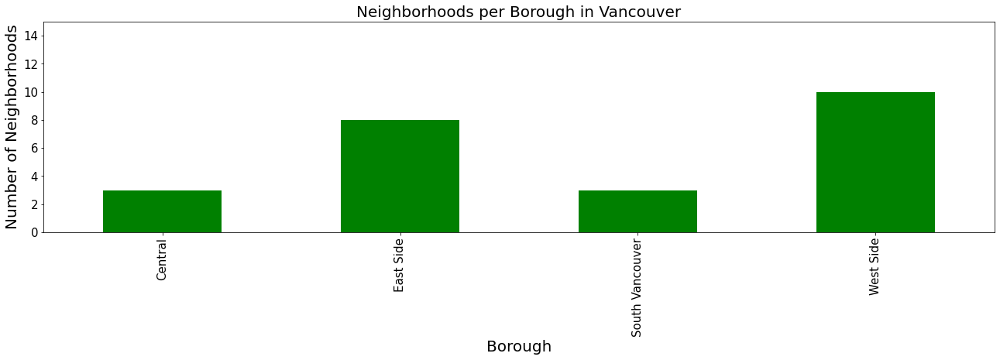

In [108]:
ax00 = vnc_neigh_bor.groupby('Borough')['Neighbourhood'].count().plot.bar(figsize=(22,5),color='green', fontsize = 15)
ax00.set_title('Neighborhoods per Borough in Vancouver', fontsize = 20)
ax00.set_xlabel('Borough',fontsize = 20)
ax00.set_ylabel('Number of Neighborhoods',fontsize = 20)
ax00.set_ylim(0,15)
plt.show()

### 2.3 Vancouver Population Data<a id="2.3"></a>

In [6]:
#Vancouver Population Data
van_pop_df = pd.read_csv('https://raw.githubusercontent.com/rvidigalm/IBM-Coursera-Capstone-Project/main/vancouver%20neighbourhoods%20and%20population.csv', index_col=None)
van_pop_df.head()

,Neighborhood,Borough,Population
0,West End,Central,44543
1,Central Business District,Central,54690
2,Hastings-Sunrise,East Side,33992
3,Grandview-Woodland,East Side,27297
4,Mount Pleasant,East Side,26400


In [90]:
van_pop_df.groupby('Borough')['Population'].sum()

Borough
Central             99256
East Side          255905
South Vancouver     60821
West Side          190764
Name: Population, dtype: int64

### 2.4 Vancouver Geocode Data<a id="2.4"></a>

In [7]:
Latitude = []
Longitude = []

Neighbourhood = vnc_neigh_bor['Neighbourhood'].unique()

key = '830323b5ca694362904814ff0a11b803'
geocoder = OpenCageGeocode(key)

for i in range(len(Neighbourhood)):
    address = '{}, Vancouver, BC, Canada'.format(Neighbourhood[i])
    location = geocoder.geocode(address)
    Latitude.append(location[0]['geometry']['lat'])
    Longitude.append(location[0]['geometry']['lng'])
    
print(Latitude, Longitude)

#print('The geograpical coordinate of Vancouver City are {}, {}.'.format(latitude, longitude))

[49.2841308, 49.2714086, 49.2787139, 49.2758495, 49.2640483, 49.2776935, 49.2463051, 49.2190935, 49.2619557, 49.2266149, 49.2092233, 49.2467896, 49.2694099, 49.2189795, 49.2209848, 49.2681022, 49.2448536, 49.2463051, 49.2485768, 49.2180118, 49.2464639, 49.237864, 49.3019112, 49.2346005] [-123.1317949, -123.1012588, -123.0399983, -123.0669344, -123.0962492, -123.0885393, -123.1384051, -123.0916654, -123.1304084, -123.1229433, -123.1361495, -123.0734751, -123.155267, -123.0638159, -123.1595484, -123.2026425, -123.1030349, -123.159636, -123.0401793, -123.037115, -123.1216027, -123.1843544, -123.1415405, -123.183397]


In [8]:
#Getting the DataFrame with Neighbourhood, Latitude and Longitude
van_neig_dict = {'Neighbourhood': Neighbourhood,'Latitude': Latitude,'Longitude':Longitude}
van_neig_geo = pd.DataFrame(data=van_neig_dict, columns=['Neighbourhood', 'Latitude', 'Longitude'], index=None)
van_neig_geo

,Neighbourhood,Latitude,Longitude
0,West End,49.284131,-123.131795
1,Central Business District,49.271409,-123.101259
2,Hastings-Sunrise,49.278714,-123.039998
3,Grandview-Woodland,49.275849,-123.066934
4,Mount Pleasant,49.264048,-123.096249
5,Strathcona,49.277693,-123.088539
6,Shaughnessy,49.246305,-123.138405
7,Sunset,49.219093,-123.091665
8,Fairview,49.261956,-123.130408
9,Oakridge,49.226615,-123.122943


In [9]:
#Merging both DataFrames
van_latlon=pd.merge(vnc_neigh_bor, van_neig_geo, on ='Neighbourhood')
van_latlon

,Neighbourhood,Borough,Latitude,Longitude
0,West End,Central,49.284131,-123.131795
1,Central Business District,Central,49.271409,-123.101259
2,Hastings-Sunrise,East Side,49.278714,-123.039998
3,Grandview-Woodland,East Side,49.275849,-123.066934
4,Mount Pleasant,East Side,49.264048,-123.096249
5,Strathcona,East Side,49.277693,-123.088539
6,Shaughnessy,West Side,49.246305,-123.138405
7,Sunset,East Side,49.219093,-123.091665
8,Fairview,West Side,49.261956,-123.130408
9,Oakridge,West Side,49.226615,-123.122943


### 2.5 Vancouver Foursquare Data<a id="2.5"></a>

In [10]:
#Four Square Credentials

CLIENT_ID = '3J4CRKON4WKVGQ2UAFPNNW0MKRR33PNNBGXMHORQU2JQ4ZSC'
CLIENT_SECRET = 'HJCMBIGZOEXCH1SIYUHU4W1CRMIYDQVYGRSMD4XDTUFMUYNC'
VERSION = '20191101'
LIMIT = 100

print('Your credentails:')
print('CLIENT_ID: ' + CLIENT_ID)
print('CLIENT_SECRET:' + CLIENT_SECRET)

Your credentails:
CLIENT_ID: 3J4CRKON4WKVGQ2UAFPNNW0MKRR33PNNBGXMHORQU2JQ4ZSC
CLIENT_SECRET:HJCMBIGZOEXCH1SIYUHU4W1CRMIYDQVYGRSMD4XDTUFMUYNC


In [11]:
# Use the function from the lab to repeat the same process to all the neighborhoods in Vancouver
def getNearbyVenues(names, latitudes, longitudes, radius=2500):
    
    venues_list=[]
    for name, lat, lng in zip(names, latitudes, longitudes):
        print(name)
            
        # create the API request URL
        url = 'https://api.foursquare.com/v2/venues/explore?&client_id={}&client_secret={}&v={}&ll={},{}&radius={}&limit={}'.format(
            CLIENT_ID, 
            CLIENT_SECRET, 
            VERSION, 
            lat, 
            lng, 
            radius, 
            LIMIT)
# make the GET request
        results = requests.get(url).json()["response"]['groups'][0]['items']
        
        # return only relevant information for each nearby venue
        venues_list.append([(
            name, 
            lat, 
            lng, 
            v['venue']['name'], 
            v['venue']['location']['lat'], 
            v['venue']['location']['lng'],  
            v['venue']['categories'][0]['name']) for v in results])

    nearby_venues = pd.DataFrame([item for venue_list in venues_list for item in venue_list])
    nearby_venues.columns = ['Neighborhood', 
                  'Neighborhood Latitude', 
                  'Neighborhood Longitude', 
                  'Venue', 
                  'Venue Latitude', 
                  'Venue Longitude', 
                  'Venue Category']
    
    return(nearby_venues)

### 2.6 Data Wrangling<a id="2.6"></a>

In [12]:
vnc_venues = getNearbyVenues(names=van_latlon['Neighbourhood'],
                                   latitudes=van_latlon['Latitude'],
                                   longitudes=van_latlon['Longitude']
                                  )

West End
Central Business District
Hastings-Sunrise
Grandview-Woodland
Mount Pleasant
Strathcona
Shaughnessy
Sunset
Fairview
Oakridge
Marpole
Kensington-Cedar Cottage
Kitsilano
Victoria-Fraserview
Kerrisdale
West Point Grey
Riley Park
Arbutus Ridge
Renfrew-Collingwood
Killarney
South Cambie
Dunbar-Southlands
Stanley Park
Musqueam


In [13]:
print(vnc_venues.shape)
vnc_venues.head()

(2209, 7)


,Neighborhood,Neighborhood Latitude,Neighborhood Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
0,West End,49.284131,-123.131795,COBS Bread,49.281379,-123.132668,Bakery
1,West End,49.284131,-123.131795,Little Sister's Bookstore,49.282059,-123.134373,Bookstore
2,West End,49.284131,-123.131795,Ramen Danbo,49.287406,-123.129028,Ramen Restaurant
3,West End,49.284131,-123.131795,La Belle Patate,49.281977,-123.133623,Restaurant
4,West End,49.284131,-123.131795,Le Crocodile Restaurant,49.282658,-123.125287,French Restaurant


### 2.7 Data Exploration<a id="2.7"></a>

In [14]:
vnc_venues.groupby('Neighborhood').count().drop(['Venue Latitude','Venue Longitude','Venue Category','Neighborhood Latitude', 'Neighborhood Longitude'], axis = 1)

,Venue
Neighborhood,
Arbutus Ridge,100
Central Business District,100
Dunbar-Southlands,58
Fairview,100
Grandview-Woodland,81
Hastings-Sunrise,100
Kensington-Cedar Cottage,100
Kerrisdale,100
Killarney,92


In [15]:
print('There are {} uniques categories.'.format(len(vnc_venues['Venue Category'].unique())))

There are 213 uniques categories.


### 2.8 Explore Vancouver Neighborhoods<a id="2.8"></a>

#### Fetching the Geographical co-ordiantes of Vancouver to plot on Map

In [16]:
address = 'Vancouver, BC, Canada'

location = geocoder.geocode(address)
latitude = location[0]['geometry']['lat']
longitude = location[0]['geometry']['lng']

print('The geograpical coordinate of Vancouver, Canada are {}, {}.'.format(latitude, longitude))

The geograpical coordinate of Vancouver, Canada are 49.2608724, -123.1139529.


#### Using Folium to plot Vancouver City's Borough and Neighborhoods

In [17]:
van_map = folium.Map(location=[latitude, longitude], zoom_start=12)

# add markers to map
for lat, lng, borough, neighborhood in zip(van_latlon['Latitude'], van_latlon['Longitude'], van_latlon['Borough'], van_latlon['Neighbourhood']):
    label = '{}, {}'.format(neighborhood, borough)
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=5,
        popup=label,
        color='red',
        fill=True,
        fill_color='#3186cc',
        fill_opacity=0.7,
        parse_html=False).add_to(van_map)  
    
van_map

### 2.9 Explore Vancouver 5 Most Common Venues With Foursquare API<a id="2.9"></a>

One Hot Encoding to Analyze Each Neighborhood

In [19]:
# one hot encoding
vnc_onehot = pd.get_dummies(vnc_venues[['Venue Category']], prefix="", prefix_sep="")

# add neighborhood column back to dataframe
vnc_onehot['Neighborhood'] = vnc_venues['Neighborhood'] 

# move neighborhood column to the first column
fixed_columns = [vnc_onehot.columns[-1]] + list(vnc_onehot.columns[:-1])
vnc_onehot = vnc_onehot[fixed_columns]

vnc_onehot

,Neighborhood,Accessories Store,American Restaurant,Amphitheater,Aquarium,Art Gallery,Arts & Crafts Store,Asian Restaurant,Athletics & Sports,Auto Dealership,BBQ Joint,Bagel Shop,Bakery,Bank,Bar,Baseball Field,Baseball Stadium,Beach,Beer Bar,Beer Garden,Beer Store,Belgian Restaurant,Board Shop,Boat or Ferry,Bookstore,Boutique,Boxing Gym,Brazilian Restaurant,Breakfast Spot,Brewery,Bubble Tea Shop,Building,Burger Joint,Burrito Place,Bus Line,Bus Station,Bus Stop,Business Service,Café,Cajun / Creole Restaurant,Camera Store,Candy Store,Cantonese Restaurant,Caribbean Restaurant,Casino,Cheese Shop,Chinese Restaurant,Chocolate Shop,Church,Clothing Store,Cocktail Bar,Coffee Shop,Comfort Food Restaurant,Concert Hall,Convenience Store,Cosmetics Shop,Cuban Restaurant,Curling Ice,Dance Studio,Deli / Bodega,Department Store,Dessert Shop,Dim Sum Restaurant,Diner,Discount Store,Dog Run,Donut Shop,Electronics Store,Escape Room,Event Space,Fair,Falafel Restaurant,Farm,Farmers Market,Fast Food Restaurant,Field,Filipino Restaurant,Food & Drink Shop,Food Court,Food Truck,French Restaurant,Fried Chicken Joint,Frozen Yogurt Shop,Furniture / Home Store,Garden,Garden Center,Gas Station,Gastropub,German Restaurant,Gift Shop,Golf Course,Gourmet Shop,Greek Restaurant,Grocery Store,Gym,Gym / Fitness Center,Gym Pool,Hardware Store,Health Food Store,Hobby Shop,Hockey Arena,Hostel,Hot Dog Joint,Hotel,Ice Cream Shop,Indian Restaurant,Indie Movie Theater,Insurance Office,Irish Pub,Italian Restaurant,Japanese Restaurant,Jewelry Store,Juice Bar,Karaoke Bar,Kids Store,Kitchen Supply Store,Korean Restaurant,Lake,Latin American Restaurant,Lebanese Restaurant,Light Rail Station,Lighthouse,Lingerie Store,Liquor Store,Lounge,Mac & Cheese Joint,Malay Restaurant,Market,Massage Studio,Mediterranean Restaurant,Metro Station,Mexican Restaurant,Middle Eastern Restaurant,Miscellaneous Shop,Motorcycle Shop,Movie Theater,Museum,Music Store,Music Venue,Nail Salon,New American Restaurant,Noodle House,Office,Optical Shop,Outdoor Sculpture,Outdoor Supply Store,Paper / Office Supplies Store,Park,Performing Arts Venue,Pet Store,Pharmacy,Pie Shop,Pizza Place,Playground,Plaza,Poke Place,Pool,Portuguese Restaurant,Pub,Racetrack,Ramen Restaurant,Record Shop,Restaurant,Salad Place,Sandwich Place,Scandinavian Restaurant,Scenic Lookout,Science Museum,Sculpture Garden,Seafood Restaurant,Shanghai Restaurant,Shopping Mall,Shopping Plaza,Skating Rink,Soccer Field,Soccer Stadium,Social Club,South American Restaurant,Southern / Soul Food Restaurant,Spa,Spanish Restaurant,Sporting Goods Shop,Sports Bar,Stadium,Stationery Store,Steakhouse,Storage Facility,Supermarket,Sushi Restaurant,Szechuan Restaurant,Taco Place,Tapas Restaurant,Tea Room,Tech Startup,Tennis Court,Thai Restaurant,Theater,Theme Park,Theme Park Ride / Attraction,Thrift / Vintage Store,Tiki Bar,Toy / Game Store,Trade School,Trail,Vegetarian / Vegan Restaurant,Video Store,Vietnamese Restaurant,Volleyball Court,Water Park,Waterfront,Wine Bar,Wine Shop,Women's Store,Yoga Studio
0,West End,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1,West End,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2,West End,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,

In [20]:
vnc_onehot.shape

(2209, 214)

In [21]:
vnc_grouped = vnc_onehot.groupby('Neighborhood').mean().reset_index()
vnc_grouped.head()

,Neighborhood,Accessories Store,American Restaurant,Amphitheater,Aquarium,Art Gallery,Arts & Crafts Store,Asian Restaurant,Athletics & Sports,Auto Dealership,BBQ Joint,Bagel Shop,Bakery,Bank,Bar,Baseball Field,Baseball Stadium,Beach,Beer Bar,Beer Garden,Beer Store,Belgian Restaurant,Board Shop,Boat or Ferry,Bookstore,Boutique,Boxing Gym,Brazilian Restaurant,Breakfast Spot,Brewery,Bubble Tea Shop,Building,Burger Joint,Burrito Place,Bus Line,Bus Station,Bus Stop,Business Service,Café,Cajun / Creole Restaurant,Camera Store,Candy Store,Cantonese Restaurant,Caribbean Restaurant,Casino,Cheese Shop,Chinese Restaurant,Chocolate Shop,Church,Clothing Store,Cocktail Bar,Coffee Shop,Comfort Food Restaurant,Concert Hall,Convenience Store,Cosmetics Shop,Cuban Restaurant,Curling Ice,Dance Studio,Deli / Bodega,Department Store,Dessert Shop,Dim Sum Restaurant,Diner,Discount Store,Dog Run,Donut Shop,Electronics Store,Escape Room,Event Space,Fair,Falafel Restaurant,Farm,Farmers Market,Fast Food Restaurant,Field,Filipino Restaurant,Food & Drink Shop,Food Court,Food Truck,French Restaurant,Fried Chicken Joint,Frozen Yogurt Shop,Furniture / Home Store,Garden,Garden Center,Gas Station,Gastropub,German Restaurant,Gift Shop,Golf Course,Gourmet Shop,Greek Restaurant,Grocery Store,Gym,Gym / Fitness Center,Gym Pool,Hardware Store,Health Food Store,Hobby Shop,Hockey Arena,Hostel,Hot Dog Joint,Hotel,Ice Cream Shop,Indian Restaurant,Indie Movie Theater,Insurance Office,Irish Pub,Italian Restaurant,Japanese Restaurant,Jewelry Store,Juice Bar,Karaoke Bar,Kids Store,Kitchen Supply Store,Korean Restaurant,Lake,Latin American Restaurant,Lebanese Restaurant,Light Rail Station,Lighthouse,Lingerie Store,Liquor Store,Lounge,Mac & Cheese Joint,Malay Restaurant,Market,Massage Studio,Mediterranean Restaurant,Metro Station,Mexican Restaurant,Middle Eastern Restaurant,Miscellaneous Shop,Motorcycle Shop,Movie Theater,Museum,Music Store,Music Venue,Nail Salon,New American Restaurant,Noodle House,Office,Optical Shop,Outdoor Sculpture,Outdoor Supply Store,Paper / Office Supplies Store,Park,Performing Arts Venue,Pet Store,Pharmacy,Pie Shop,Pizza Place,Playground,Plaza,Poke Place,Pool,Portuguese Restaurant,Pub,Racetrack,Ramen Restaurant,Record Shop,Restaurant,Salad Place,Sandwich Place,Scandinavian Restaurant,Scenic Lookout,Science Museum,Sculpture Garden,Seafood Restaurant,Shanghai Restaurant,Shopping Mall,Shopping Plaza,Skating Rink,Soccer Field,Soccer Stadium,Social Club,South American Restaurant,Southern / Soul Food Restaurant,Spa,Spanish Restaurant,Sporting Goods Shop,Sports Bar,Stadium,Stationery Store,Steakhouse,Storage Facility,Supermarket,Sushi Restaurant,Szechuan Restaurant,Taco Place,Tapas Restaurant,Tea Room,Tech Startup,Tennis Court,Thai Restaurant,Theater,Theme Park,Theme Park Ride / Attraction,Thrift / Vintage Store,Tiki Bar,Toy / Game Store,Trade School,Trail,Vegetarian / Vegan Restaurant,Video Store,Vietnamese Restaurant,Volleyball Court,Water Park,Waterfront,Wine Bar,Wine Shop,Women's Store,Yoga Studio
0,Arbutus Ridge,0.0,0.020000,0.000000,0.0,0.0,0.000000,0.010000,0.0,0.000000,0.0,0.00,0.060000,0.010000,0.000000,0.000000,0.0,0.00,0.00,0.000000,0.0,0.00,0.0,0.000000,0.020000,0.0,0.00,0.0,0.010000,0.000000,0.02,0.0,0.010000,0.0,0.000000,0.000000,0.0,0.000000,0.050000,0.0,0.0,0.0,0.0,0.010000,0.0,0.00,0.030000,0.0,0.0,0.00,0.00,0.120000,0.0,0.00,0.0,0.00,0.000000,0.0,0.000000,0.010000,0.0,0.020000,0.0,0.00,0.01,0.00,0.00,0.0,0.0,0.010000,0.000000,0.0,0.000000,0.000000,0.0,0.0,0.0,0.01,0.0,0.010000,0.01,0.000000,0.0,0.02,0.02,0.010000,0.0,0.00,0.00,0.010000,0.000000,0.000000,0.01,0.040000,0.000000,0.000000,0.010000,0.000000,0.0,0.0,0.000000,0.0,0.0,0.00,0.000000,0.010000,0.010000,0.000000,0.0,0.030000,0.040000,0.0,0.00,0.0,0.0,0.01,0.0,0.000000,0.0,0.00,0.0,0.0,0.0,0.000000,0.0,0.01,0.0,0.000000,0.0,0.010000,0.0,0.000000,0.01,0.0,0.0,0.0,0.00,0.000000,0.000000,0.0,0.0,0.00,0.000000,0.0,0.00,0.0,0.0,0.030000,0.0,0.01,0.040000,0.0,0.020000,0.0,0.0,0.00,0.000000,0.

In [22]:
vnc_grouped.shape

(24, 214)

In [23]:
num_top_venues = 5

for hood in vnc_grouped['Neighborhood']:
    print("----"+hood+"----")
    temp = vnc_grouped[vnc_grouped['Neighborhood'] == hood].T.reset_index()
    temp.columns = ['venue','freq']
    temp = temp.iloc[1:]
    temp['freq'] = temp['freq'].astype(float)
    temp = temp.round({'freq': 2})
    print(temp.sort_values('freq', ascending=False).reset_index(drop=True).head(num_top_venues))
    print('\n')

----Arbutus Ridge----
                 venue  freq
0          Coffee Shop  0.12
1               Bakery  0.06
2                 Café  0.05
3  Japanese Restaurant  0.04
4             Pharmacy  0.04


----Central Business District----
         venue  freq
0  Coffee Shop  0.09
1   Restaurant  0.06
2   Taco Place  0.05
3      Brewery  0.04
4        Hotel  0.04


----Dunbar-Southlands----
                venue  freq
0         Coffee Shop  0.10
1       Grocery Store  0.07
2  Italian Restaurant  0.05
3            Pharmacy  0.05
4              Bakery  0.03


----Fairview----
         venue  freq
0       Bakery  0.10
1         Park  0.06
2  Coffee Shop  0.06
3   Restaurant  0.05
4         Café  0.04


----Grandview-Woodland----
                venue  freq
0                Park  0.07
1             Brewery  0.07
2         Coffee Shop  0.05
3                Café  0.04
4  Mexican Restaurant  0.04


----Hastings-Sunrise----
                   venue  freq
0                   Café  0.08
1            Co

Now let's create the new dataframe and display the top 5 venues for each neighborhood.

In [24]:
def return_most_common_venues(row, num_top_venues):
    row_categories = row.iloc[1:]
    row_categories_sorted = row_categories.sort_values(ascending=False)
    
    return row_categories_sorted.index.values[0:num_top_venues]

In [25]:
# Number of Top Venues
num_top_venues = 5

indicators = ['st', 'nd', 'rd']

# create columns according to number of top venues
columns = ['Neighborhood']
for ind in np.arange(num_top_venues):
    try:
        columns.append('{}{} Most Common Venue'.format(ind+1, indicators[ind]))
    except:
        columns.append('{}th Most Common Venue'.format(ind+1))

# create a new dataframe
neighborhoods_venues_sorted = pd.DataFrame(columns=columns)
neighborhoods_venues_sorted['Neighborhood'] = vnc_grouped['Neighborhood']

for ind in np.arange(vnc_grouped.shape[0]):
    neighborhoods_venues_sorted.iloc[ind, 1:] = return_most_common_venues(vnc_grouped.iloc[ind, :], num_top_venues)

neighborhoods_venues_sorted.head()

,Neighborhood,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue
0,Arbutus Ridge,Coffee Shop,Bakery,Café,Japanese Restaurant,Pharmacy
1,Central Business District,Coffee Shop,Restaurant,Taco Place,Brewery,Hotel
2,Dunbar-Southlands,Coffee Shop,Grocery Store,Italian Restaurant,Pharmacy,Bakery
3,Fairview,Bakery,Park,Coffee Shop,Restaurant,Café
4,Grandview-Woodland,Park,Brewery,Coffee Shop,Café,Mexican Restaurant


### 2.10 Explore Vancouver Coffee Shops and Competitors With Foursquare API<a id="2.10"></a>

Competitors are venues that compete in our segment

In [28]:
vancouver_cafe = vnc_venues[( vnc_venues['Venue Category'] == 'Café') | (vnc_venues['Venue Category'] == 'Cafeteria') | (vnc_venues['Venue Category'] == 'Coffee Shop') | (vnc_venues['Venue Category'] == 'Bakery') | (vnc_venues['Venue Category'] == 'Breakfast Spot') | (vnc_venues['Venue Category'] == 'Dessert Shop') | (vnc_venues['Venue Category'] == 'Fast Food Restaurant') | (vnc_venues['Venue Category'] == 'Bubble Tea Shop')]
vancouver_cafe

,Neighborhood,Neighborhood Latitude,Neighborhood Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
0,West End,49.284131,-123.131795,COBS Bread,49.281379,-123.132668,Bakery
8,West End,49.284131,-123.131795,Greenhorn Cafe,49.286628,-123.134038,Café
10,West End,49.284131,-123.131795,Breka Bakery & Café,49.285854,-123.127156,Bakery
15,West End,49.284131,-123.131795,Rocky Mountain Chocolate Factory,49.283626,-123.123306,Dessert Shop
22,West End,49.284131,-123.131795,PappaRoti,49.288716,-123.130916,Coffee Shop
33,West End,49.284131,-123.131795,Thierry Chocolaterie Patisserie,49.284892,-123.122951,Dessert Shop
55,West End,49.284131,-123.131795,Nero Belgian Waffle Bar,49.278451,-123.122024,Dessert Shop
62,West End,49.284131,-123.131795,Nero Belgian Waffle Bar,49.290543,-123.133905,Dessert Shop
66,West End,49.284131,-123.131795,Breka Bakery & Cafe,49.278496,-123.128062,Bakery
74,West End,49.284131,-123.131795,Delany's Coffee House,49.288195,-123.140433,Coffee Shop


In [29]:
vancouver_latlon=vancouver_cafe[['Venue Latitude','Venue Longitude']]
vancouver_latlon.shape

(391, 2)

In [30]:
vancouver_cafe.groupby('Neighborhood').count().drop(['Venue Latitude','Venue Longitude','Venue Category','Neighborhood Latitude', 'Neighborhood Longitude'], axis = 1)

,Venue
Neighborhood,
Arbutus Ridge,28
Central Business District,21
Dunbar-Southlands,12
Fairview,24
Grandview-Woodland,9
Hastings-Sunrise,23
Kensington-Cedar Cottage,12
Kerrisdale,18
Killarney,17


In [34]:
print('There are {} uniques categories in this new Data Frame.'.format(len(vancouver_cafe['Venue Category'].unique())))

There are 7 uniques categories in this new Data Frame.


## 3. Machine Learning<a id="3"></a>

### 3.1 Elbow Visualizer<a id="3.1"></a>

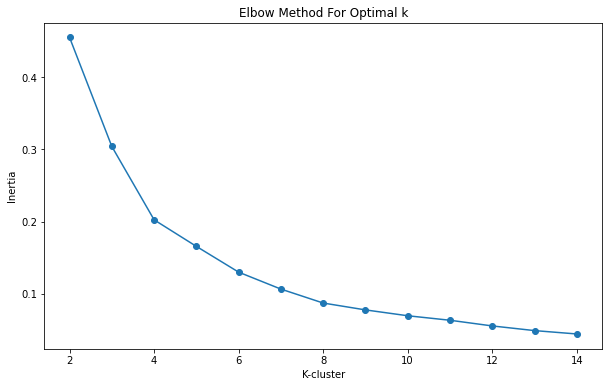

In [35]:
# Lista de valores de K
Ks = range(2, 15)


#van_clustering = vnc_grouped.drop('Neighbourhood', 1)
van_clustering = vancouver_latlon

# Lista para as métricas
valores_metrica = []

# Loop por diferentes modelos com diferentes valores de K
for K in Ks:
    modelo = KMeans(n_clusters = K, random_state = 101)
    modelo.fit(van_clustering)
    valores_metrica.append(modelo.inertia_)
    
plt.figure(figsize=(10, 6))
plt.plot(Ks, valores_metrica, 'o-')
plt.xlabel("K-cluster")
plt.ylabel("Inertia")
plt.title('Elbow Method For Optimal k')
plt.show()

### 3.2 Silhouette Metric<a id="3.2"></a>

In [36]:
from sklearn.metrics import silhouette_score

for i in range(2,10):
    
  kmeans_ = KMeans(n_clusters=i).fit(van_clustering)
  labels_ = kmeans_.labels_
  coef = silhouette_score(van_clustering,labels_)
  
  print("N_cluster: {}, score: {}".format(i,coef))

N_cluster: 2, score: 0.4081282635647124
N_cluster: 3, score: 0.40381596664684355
N_cluster: 4, score: 0.4586725712185001
N_cluster: 5, score: 0.40909285301191994
N_cluster: 6, score: 0.4335069191844513
N_cluster: 7, score: 0.4575461278366868
N_cluster: 8, score: 0.46187968785821837
N_cluster: 9, score: 0.4576368537307136


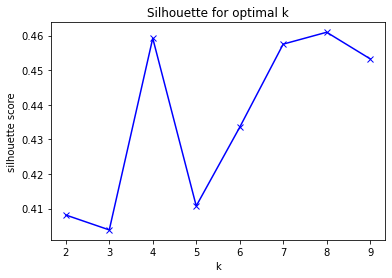

In [37]:
from sklearn.metrics import silhouette_score
sil = []
k_sil = range(2,10)

for k in k_sil:
  kmeans = KMeans(n_clusters = k,random_state=0).fit(van_clustering)
  labels = kmeans.labels_
  sil.append(silhouette_score(van_clustering, labels, metric = 'euclidean'))

plt.plot(k_sil, sil, 'bx-')
plt.xlabel('k')
plt.ylabel('silhouette score')
plt.title('Silhouette for optimal k')
plt.show()

After Silhoutte and Elbow Methods, I chose 8 as an optimanl K.

### 3.3 K-means Clustering Of Vancouver Neighbourhood Coffee Shops And Contenders <a id="3.3"></a>

In [38]:
# set number of clusters
kclusters = 8

#vnc_grouped_clustering = vnc_grouped.drop('Neighbourhood', 1)

# run k-means clustering
kmeans = KMeans(n_clusters=kclusters, random_state=0).fit(van_clustering)

# check cluster labels generated for each row in the dataframe
kmeans.labels_[0:10]

array([4, 4, 4, 4, 4, 4, 4, 4, 4, 4])

In [39]:
vancouver_cafe['Cluster Labels'] = kmeans.labels_

<ipython-input-39-15097c529ad4>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  vancouver_cafe['Cluster Labels'] = kmeans.labels_


In [40]:
vancouver_cafe.head()

,Neighborhood,Neighborhood Latitude,Neighborhood Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category,Cluster Labels
0,West End,49.284131,-123.131795,COBS Bread,49.281379,-123.132668,Bakery,4
8,West End,49.284131,-123.131795,Greenhorn Cafe,49.286628,-123.134038,Café,4
10,West End,49.284131,-123.131795,Breka Bakery & Café,49.285854,-123.127156,Bakery,4
15,West End,49.284131,-123.131795,Rocky Mountain Chocolate Factory,49.283626,-123.123306,Dessert Shop,4
22,West End,49.284131,-123.131795,PappaRoti,49.288716,-123.130916,Coffee Shop,4


### 3.4 Visualize The Results For Vancouver Clusters<a id="3.4"></a>

Trying to predict in which cluster these coordinates would be in

In [41]:
variavel=np.array([49.271409 , -123.101259])
kmeans.predict(variavel.reshape(1,-1))

array([7])

In [42]:
van_cafe_group=vancouver_cafe.groupby(['Cluster Labels'])['Venue Category'].count()
van_cafe_group

Cluster Labels
0    50
1    54
2    25
3    48
4    62
5    41
6    34
7    77
Name: Venue Category, dtype: int64

In [43]:
# create map
map_clusters = folium.Map(location=[latitude, longitude], zoom_start=12)

# set color scheme for the clusters
x = np.arange(kclusters)
ys = [i + x + (i*x)**2 for i in range(kclusters)]
colors_array = cm.rainbow(np.linspace(0, 1, len(ys)))
rainbow = [colors.rgb2hex(i) for i in colors_array]

# add markers to the map
markers_colors = []
for lat, lon, poi, cluster in zip(vancouver_cafe['Venue Latitude'], vancouver_cafe['Venue Longitude'], vancouver_cafe['Neighborhood'], vancouver_cafe['Cluster Labels']):
    label = folium.Popup(str(poi) + ' Cluster ' + str(cluster), parse_html=True)
    folium.CircleMarker(
        [lat, lon],
        radius=5,
        popup=label,
        color=rainbow[cluster-1],
        fill=True,
        fill_color=rainbow[cluster-1],
        fill_opacity=0.7).add_to(map_clusters)
       
map_clusters

## 4. Neighborhood Coffe Shops And Contenders Summary<a id="4"></a>

In [44]:
# one hot encoding
vnc_cafe_onehot = pd.get_dummies(vancouver_cafe[['Venue Category']], prefix="", prefix_sep="")

# add neighborhood column back to dataframe
vnc_cafe_onehot['Neighborhood'] = vancouver_cafe['Neighborhood'] 

# move neighborhood column to the first column
fixed_columns = [vnc_cafe_onehot.columns[-1]] + list(vnc_cafe_onehot.columns[:-1])
vnc_cafe_onehot = vnc_cafe_onehot[fixed_columns]

vnc_cafe_onehot

,Neighborhood,Bakery,Breakfast Spot,Bubble Tea Shop,Café,Coffee Shop,Dessert Shop,Fast Food Restaurant
0,West End,1,0,0,0,0,0,0
8,West End,0,0,0,1,0,0,0
10,West End,1,0,0,0,0,0,0
15,West End,0,0,0,0,0,1,0
22,West End,0,0,0,0,1,0,0
33,West End,0,0,0,0,0,1,0
55,West End,0,0,0,0,0,1,0
62,West End,0,0,0,0,0,1,0
66,West End,1,0,0,0,0,0,0
74,West End,0,0,0,0,1,0,0


In [45]:
vancouver_cafe2 = vnc_cafe_onehot.groupby('Neighborhood').sum().reset_index()
vancouver_cafe2

,Neighborhood,Bakery,Breakfast Spot,Bubble Tea Shop,Café,Coffee Shop,Dessert Shop,Fast Food Restaurant
0,Arbutus Ridge,6,1,2,5,12,2,0
1,Central Business District,4,2,0,4,9,2,0
2,Dunbar-Southlands,2,0,0,2,6,2,0
3,Fairview,10,1,1,4,6,2,0
4,Grandview-Woodland,0,1,0,3,4,1,0
5,Hastings-Sunrise,5,2,0,8,7,1,0
6,Kensington-Cedar Cottage,2,0,0,5,5,0,0
7,Kerrisdale,2,0,1,3,8,2,2
8,Killarney,3,0,2,2,8,1,1
9,Kitsilano,7,2,0,4,7,2,0


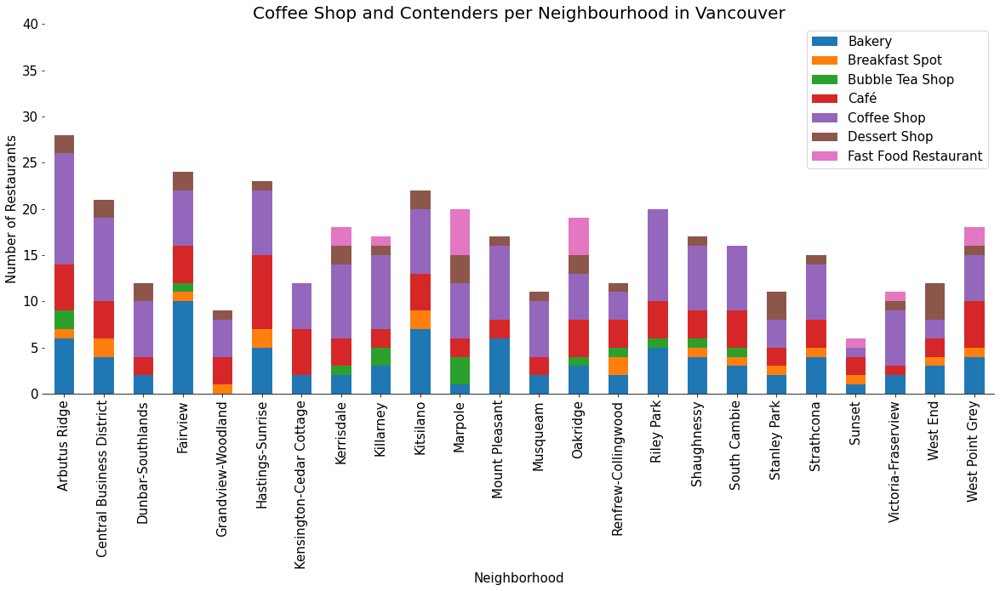

In [46]:
van_nei_cafe = vancouver_cafe2.copy()
van_nei_cafe.set_index('Neighborhood', inplace = True)
ax01 = van_nei_cafe.plot(kind = 'bar', figsize = (20,8), fontsize = 15, align = 'center', stacked = True)
ax01.set_title('Coffee Shop and Contenders per Neighbourhood in Vancouver', fontsize = 20)
ax01.legend(fontsize = 15)
ax01.set_xlabel('Neighborhood',fontsize = 15)
ax01.set_ylabel('Number of Restaurants',fontsize =15)
ax01.set_ylim(0,40)
ax01.spines['top'].set_visible(False)
ax01.spines['left'].set_visible(False)
ax01.spines['right'].set_visible(False)
plt.show()

### 4.1 Coffee Shop Per Neighborhood<a id="4.1"></a>

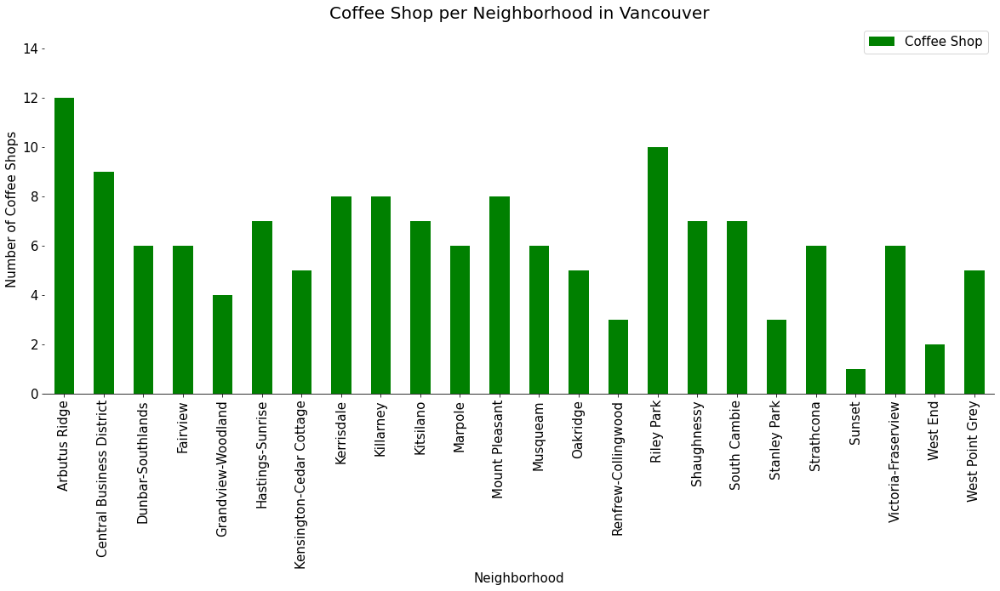

In [107]:
van_cafe = vancouver_cafe2.copy()
van_cafe.drop(columns = ['Bakery',
                                                           'Breakfast Spot', 
                                                           'Café',
                                                           'Bubble Tea Shop',
                                                           'Dessert Shop',
                                                           'Fast Food Restaurant'], inplace = True)
van_cafe.set_index('Neighborhood', inplace = True)
ax01 = van_cafe.plot(kind = 'bar',color = 'green', figsize = (20,8), fontsize = 15, align = 'center')
ax01.set_title('Coffee Shop per Neighborhood in Vancouver', fontsize = 20)
ax01.legend(fontsize = 15)
ax01.set_xlabel('Neighborhood',fontsize = 15)
ax01.set_ylabel('Number of Coffee Shops',fontsize =15)
ax01.set_ylim(0,15)
ax01.spines['top'].set_visible(False)
ax01.spines['left'].set_visible(False)
ax01.spines['right'].set_visible(False)
plt.show()

### 4.2 Coffee Shop Per Neighborhood And Per A Thousand Habitants<a id="4.2"></a>

In [77]:
van_cafe_data = pd.merge(van_cafe, van_pop_df, on = 'Neighborhood')
van_cafe_data['Coffee Shop per 1000 habitants'] = 1000*(van_cafe_data['Coffee Shop']/van_cafe_data['Population'])
van_cafe_data

,Neighborhood,Coffee Shop,Borough,Population,Coffee Shop per 1000 habitants
0,Arbutus Ridge,12,West Side,15908,0.754337
1,Central Business District,9,Central,54690,0.164564
2,Dunbar-Southlands,6,West Side,21754,0.275811
3,Fairview,6,West Side,31432,0.190888
4,Grandview-Woodland,4,East Side,27297,0.146536
5,Hastings-Sunrise,7,East Side,33992,0.205931
6,Kensington-Cedar Cottage,5,East Side,47471,0.105327
7,Kerrisdale,8,West Side,14732,0.543036
8,Killarney,8,South Vancouver,28458,0.281116
9,Kitsilano,7,West Side,41371,0.169201


###### Stanley Park is an outlier, so it was removed. The number of Coffee Shop per a thounsand is high because Stanley Park is a neighborhood that has few habitants and it is a touristic Park.

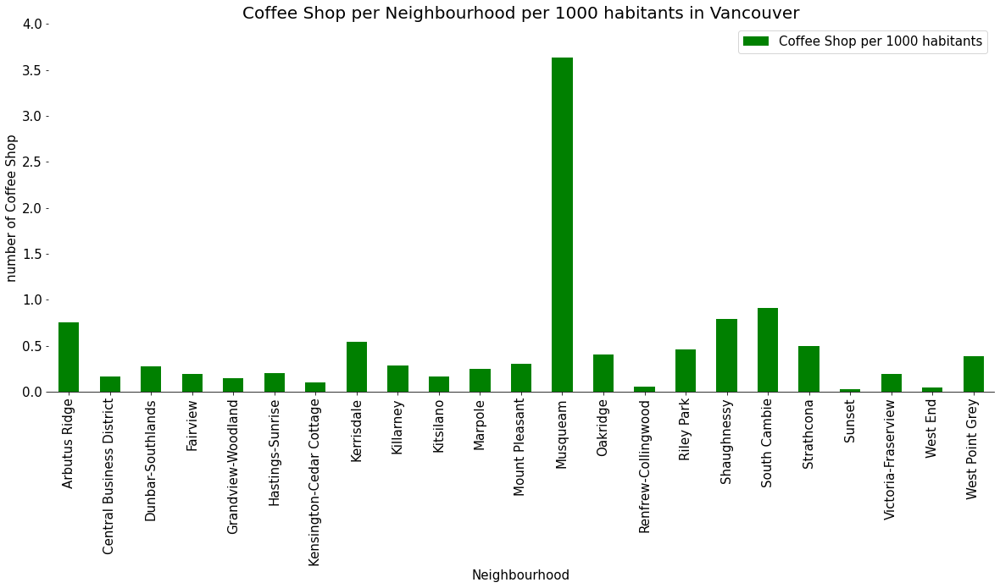

In [78]:
#Stanley Park is an outlier, so it was removed. The number of Coffee Shop per a thounsand is high because Stanley Park 
#is a neighbourhood that has few habitants and it is a touristic Park. 
van_cafe_data_thousand = van_cafe_data.copy()
van_cafe_data_thousand = van_cafe_data.replace('Stanley Park', np.nan, regex = True)
van_cafe_data_thousand.dropna(inplace = True)
van_cafe_data_thousand.drop(columns = ['Coffee Shop', 'Population',], inplace = True)
van_cafe_data_thousand.set_index('Neighborhood', inplace = True)
ax01 = van_cafe_data_thousand.plot(kind = 'bar',color = 'green', figsize = (20,8), fontsize = 15, align = 'center')
ax01.set_title('Coffee Shop per Neighbourhood per 1000 habitants in Vancouver', fontsize = 20)
ax01.legend(fontsize = 15)
ax01.set_xlabel('Neighbourhood',fontsize = 15)
ax01.set_ylabel('number of Coffee Shop',fontsize =15)
ax01.set_ylim(0,4)
ax01.spines['top'].set_visible(False)
ax01.spines['left'].set_visible(False)
ax01.spines['right'].set_visible(False)
plt.show()

### 4.3 Exploring The Clusters<a id="4.3"></a>

Culster 1

In [50]:
cluster_1=vancouver_cafe.loc[vancouver_cafe['Cluster Labels'] == 0, 
                            vancouver_cafe.columns[[0] + list(range(5, vancouver_cafe.shape[1]))]]
cluster_1

,Neighborhood,Venue Longitude,Venue Category,Cluster Labels
377,Grandview-Woodland,-123.067833,Café,0
404,Mount Pleasant,-123.090428,Bakery,0
405,Mount Pleasant,-123.090390,Coffee Shop,0
445,Mount Pleasant,-123.101113,Bakery,0
469,Mount Pleasant,-123.089974,Café,0
681,Sunset,-123.090856,Bakery,0
685,Sunset,-123.101514,Café,0
846,Oakridge,-123.101514,Café,0
855,Oakridge,-123.090856,Bakery,0
889,Oakridge,-123.101560,Café,0


Cluster 2

In [51]:
cluster_2=vancouver_cafe.loc[vancouver_cafe['Cluster Labels'] == 1, 
                            vancouver_cafe.columns[[0] + list(range(5, vancouver_cafe.shape[1]))]]
cluster_2

,Neighborhood,Venue Longitude,Venue Category,Cluster Labels
644,Shaughnessy,-123.152837,Coffee Shop,1
647,Shaughnessy,-123.157648,Coffee Shop,1
658,Shaughnessy,-123.157593,Coffee Shop,1
677,Shaughnessy,-123.150339,Coffee Shop,1
804,Fairview,-123.152837,Coffee Shop,1
810,Fairview,-123.154878,Coffee Shop,1
813,Fairview,-123.151392,Bakery,1
1133,Kitsilano,-123.154878,Coffee Shop,1
1136,Kitsilano,-123.159275,Bakery,1
1143,Kitsilano,-123.151883,Breakfast Spot,1


Cluster 3

In [52]:
cluster_3=vancouver_cafe.loc[vancouver_cafe['Cluster Labels'] == 2, 
                            vancouver_cafe.columns[[0] + list(range(5, vancouver_cafe.shape[1]))]]
cluster_3

,Neighborhood,Venue Longitude,Venue Category,Cluster Labels
1238,Victoria-Fraserview,-123.053442,Coffee Shop,2
1286,Victoria-Fraserview,-123.040876,Fast Food Restaurant,2
1301,Victoria-Fraserview,-123.051131,Café,2
1321,Victoria-Fraserview,-123.041094,Coffee Shop,2
1744,Renfrew-Collingwood,-123.034086,Bubble Tea Shop,2
1752,Renfrew-Collingwood,-123.030170,Bakery,2
1753,Renfrew-Collingwood,-123.023287,Coffee Shop,2
1759,Renfrew-Collingwood,-123.026245,Café,2
1820,Killarney,-123.034086,Bubble Tea Shop,2
1822,Killarney,-123.026245,Café,2


Cluster 4

In [53]:
cluster_4=vancouver_cafe.loc[vancouver_cafe['Cluster Labels'] == 3, 
                            vancouver_cafe.columns[[0] + list(range(5, vancouver_cafe.shape[1]))]]
cluster_4

,Neighborhood,Venue Longitude,Venue Category,Cluster Labels
628,Shaughnessy,-123.170381,Bakery,3
676,Shaughnessy,-123.157422,Café,3
899,Oakridge,-123.153661,Coffee Shop,3
908,Oakridge,-123.155798,Bakery,3
1345,Kerrisdale,-123.170381,Bakery,3
1349,Kerrisdale,-123.182066,Café,3
1350,Kerrisdale,-123.157422,Café,3
1351,Kerrisdale,-123.160344,Coffee Shop,3
1352,Kerrisdale,-123.155798,Bakery,3
1354,Kerrisdale,-123.153661,Coffee Shop,3


Cluster 5

In [54]:
cluster_5=vancouver_cafe.loc[vancouver_cafe['Cluster Labels'] == 4, 
                            vancouver_cafe.columns[[0] + list(range(5, vancouver_cafe.shape[1]))]]
cluster_5

,Neighborhood,Venue Longitude,Venue Category,Cluster Labels
0,West End,-123.132668,Bakery,4
8,West End,-123.134038,Café,4
10,West End,-123.127156,Bakery,4
15,West End,-123.123306,Dessert Shop,4
22,West End,-123.130916,Coffee Shop,4
33,West End,-123.122951,Dessert Shop,4
55,West End,-123.122024,Dessert Shop,4
62,West End,-123.133905,Dessert Shop,4
66,West End,-123.128062,Bakery,4
74,West End,-123.140433,Coffee Shop,4


Cluster 6

In [55]:
cluster_6=vancouver_cafe.loc[vancouver_cafe['Cluster Labels'] == 5, 
                            vancouver_cafe.columns[[0] + list(range(5, vancouver_cafe.shape[1]))]]
cluster_6

,Neighborhood,Venue Longitude,Venue Category,Cluster Labels
715,Sunset,-123.116783,Fast Food Restaurant,5
716,Sunset,-123.116910,Coffee Shop,5
727,Sunset,-123.119347,Breakfast Spot,5
733,Sunset,-123.095285,Café,5
848,Oakridge,-123.128831,Fast Food Restaurant,5
861,Oakridge,-123.140274,Dessert Shop,5
862,Oakridge,-123.140451,Bubble Tea Shop,5
883,Oakridge,-123.115988,Café,5
895,Oakridge,-123.137772,Café,5
909,Oakridge,-123.116783,Fast Food Restaurant,5


Cluster 7

In [56]:
cluster_7=vancouver_cafe.loc[vancouver_cafe['Cluster Labels'] == 6, 
                            vancouver_cafe.columns[[0] + list(range(5, vancouver_cafe.shape[1]))]]
cluster_7

,Neighborhood,Venue Longitude,Venue Category,Cluster Labels
204,Hastings-Sunrise,-123.057445,Coffee Shop,6
210,Hastings-Sunrise,-123.057997,Breakfast Spot,6
213,Hastings-Sunrise,-123.056351,Café,6
216,Hastings-Sunrise,-123.063803,Coffee Shop,6
217,Hastings-Sunrise,-123.055365,Café,6
219,Hastings-Sunrise,-123.060630,Café,6
221,Hastings-Sunrise,-123.014611,Dessert Shop,6
227,Hastings-Sunrise,-123.047019,Coffee Shop,6
229,Hastings-Sunrise,-123.045885,Bakery,6
230,Hastings-Sunrise,-123.014989,Bakery,6


Cluster 8

In [57]:
cluster_8=vancouver_cafe.loc[vancouver_cafe['Cluster Labels'] == 7, 
                            vancouver_cafe.columns[[0] + list(range(5, vancouver_cafe.shape[1]))]]
cluster_8

,Neighborhood,Venue Longitude,Venue Category,Cluster Labels
84,West End,-123.116859,Breakfast Spot,7
105,Central Business District,-123.106674,Bakery,7
106,Central Business District,-123.096037,Dessert Shop,7
115,Central Business District,-123.104547,Bakery,7
116,Central Business District,-123.104963,Coffee Shop,7
130,Central Business District,-123.108800,Coffee Shop,7
135,Central Business District,-123.110438,Coffee Shop,7
136,Central Business District,-123.099912,Café,7
146,Central Business District,-123.109203,Bakery,7
149,Central Business District,-123.109288,Coffee Shop,7


Cluster 9

### 4.4 Using Crime Data To Decide The Best Cluster To Open A Coffee Shop<a id="4.4"></a>

In [59]:
#Merging the first Dataframe with Neighbourhood Dataframe
vnc_boroughs_crime = pd.merge(vnc_crime_df,vnc_neigh_bor, on='Neighbourhood')

vnc_boroughs_crime.head()

,Type,Year,Month,Day,Hour,Neighbourhood,Borough
0,Break and Enter Commercial,2018,3,2,6,West End,Central
1,Break and Enter Commercial,2018,6,16,18,West End,Central
2,Break and Enter Commercial,2018,12,12,0,West End,Central
3,Break and Enter Commercial,2018,3,2,3,West End,Central
4,Break and Enter Commercial,2018,3,17,11,West End,Central


In [60]:
#Number of Crimes per Borough
vnc_boroughs_crime.dropna(inplace=True)
vnc_boroughs_crime['Borough'].value_counts()

Central            14042
East Side          12400
West Side           7204
South Vancouver     1182
Name: Borough, dtype: int64

#### Creating a Pivot Table to understand the crimes per Borough

In [61]:
vancouver_crime = pd.pivot_table(vnc_boroughs_crime,
                               values=['Year'],
                               index=['Borough'],
                               columns=['Type'],
                               aggfunc=len,
                               fill_value=0,
                               margins=True)
vancouver_crime

Year                                    \
Type            Break and Enter Commercial Break and Enter Residential/Other   
Borough                                                                        
Central                                787                               198   
East Side                              786                              1043   
South Vancouver                         49                               156   
West Side                              403                              1000   
All                                   2025                              2397   

                                                                          \
Type            Mischief Other Theft Theft from Vehicle Theft of Bicycle   
Borough                                                                    
Central             2280        2489               6871              857   
East Side           2192        1674               4754              678   
South Vancouver      187          88                483               36   
West Side           1062         696               2838              588   
All                 5721        4947              14946             2159   

                                  \
Type            Theft of Vehicle   
Borough                            
Central                      245   
East Side                    605   
South Vancouver               71   
West Side                    225   
All                         1146   

                                                                        \
Type            Vehicle Collision or Pedestrian Struck (with Fatality)   
Borough                                                                  
Central                                                          1       
East Side                                                        8       
South Vancouver                                                  1       
West Side                                                        3       
All                                                             13       

                                                                             
Type            Vehicle Collision or Pedestrian Struck (with Injury)    All  
Borough                                                                      
Central                                                        314    14042  
East Side                                                      660    12400  
South Vancouver                                                111     1182  
West Side                                                      389     7204  
All                                                           1474    34828

In [63]:
vancouver_crime.reset_index(inplace = True)
vancouver_crime.columns = vancouver_crime.columns.map(''.join)
vancouver_crime.rename(columns={'YearBreak and Enter Commercial':'Break and Enter Commercial','YearBreak and Enter Residential/Other':'Break and Enter Residential/Other','YearMischief':'Mischief','YearOther Theft':'Other Theft','YearTheft from Vehicle':'Theft from Vehicle','YearTheft of Bicyle':'Theft of Bicyle','YearTheft of Vehicle':'Theft of Vehicle','YearVehicle Colission or Pedestrian Struck (with Fatality)':'Vehicle Collision or Pedestrian Struck (with Fatality)','YearVehicle Collision or Pedestrian Struck (with Injury)':'Vehicle Collision or Pedestrian Struck (with Injury)','YearAll':'Total'}, inplace=True)
# To ignore bottom line 'All' in Borough
vancouver_crime = vancouver_crime.head(4)
vancouver_crime

C:\Users\Rvidi\anaconda3\lib\site-packages\pandas\core\frame.py:4441: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return super().rename(


,index,Borough,Break and Enter Commercial,Break and Enter Residential/Other,Mischief,Other Theft,Theft from Vehicle,YearTheft of Bicycle,Theft of Vehicle,YearVehicle Collision or Pedestrian Struck (with Fatality),Vehicle Collision or Pedestrian Struck (with Injury),Total
0,0,Central,787,198,2280,2489,6871,857,245,1,314,14042
1,1,East Side,786,1043,2192,1674,4754,678,605,8,660,12400
2,2,South Vancouver,49,156,187,88,483,36,71,1,111,1182
3,3,West Side,403,1000,1062,696,2838,588,225,3,389,7204


Pandas describe() shows some basic statistical details such as: percentile, mean, std, of a data frame or a series of numeric values

In [64]:
vancouver_crime.describe()

,index,Break and Enter Commercial,Break and Enter Residential/Other,Mischief,Other Theft,Theft from Vehicle,YearTheft of Bicycle,Theft of Vehicle,YearVehicle Collision or Pedestrian Struck (with Fatality),Vehicle Collision or Pedestrian Struck (with Injury),Total
count,4.000000,4.000000,4.000000,4.00000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000
mean,1.500000,506.250000,599.250000,1430.25000,1236.750000,3736.500000,539.750000,286.500000,3.250000,368.500000,8707.000000
std,1.290994,354.409721,488.189427,997.26572,1060.087221,2723.536977,353.955153,226.117226,3.304038,227.060198,5801.870618
min,0.000000,49.000000,156.000000,187.00000,88.000000,483.000000,36.000000,71.000000,1.000000,111.000000,1182.000000
25%,0.750000,314.500000,187.500000,843.25000,544.000000,2249.250000,450.000000,186.500000,1.000000,263.250000,5698.500000
50%,1.500000,594.500000,599.000000,1627.00000,1185.000000,3796.000000,633.000000,235.000000,2.000000,351.500000,9802.000000
75%,2.250000,786.250000,1010.750000,2214.00000,1877.750000,5283.250000,722.750000,335.000000,4.250000,456.750000,12810.500000
max,3.000000,787.000000,1043.000000,2280.00000,2489.000000,6871.000000,857.000000,605.000000,8.000000,660.000000,14042.000000


#### Borough with highest crimes

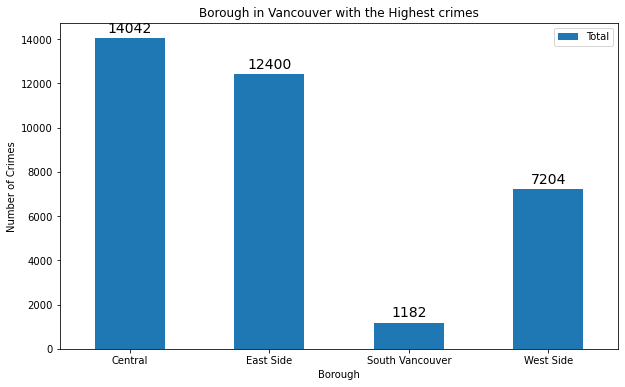

In [66]:
borough_crimes = vancouver_crime[['Borough','Total']]

borough_crimes.set_index('Borough',inplace = True)

ax = borough_crimes.plot(kind='bar', figsize=(10, 6), rot=0)

ax.set_ylabel('Number of Crimes')
ax.set_xlabel('Borough')
ax.set_title('Borough in Vancouver with the Highest crimes')

for p in ax.patches:
    ax.annotate(np.round(p.get_height(),decimals=2), 
                (p.get_x()+p.get_width()/2., p.get_height()), 
                ha='center', 
                va='center', 
                xytext=(0, 10), 
                textcoords='offset points',
                fontsize = 14,
               )

plt.show()

### 5. Results And Discussion<a id="5"></a>

In [103]:
van_cafe2 = van_cafe_data.copy()
van_cafe2.drop(columns = ['Coffee Shop per 1000 habitants', 'Neighborhood', 'Population'], inplace = True)
van_cafe2=van_cafe2.groupby(['Borough'])['Coffee Shop'].sum()
van_cafe2

Borough
Central            14
East Side          44
South Vancouver    20
West Side          69
Name: Coffee Shop, dtype: uint8

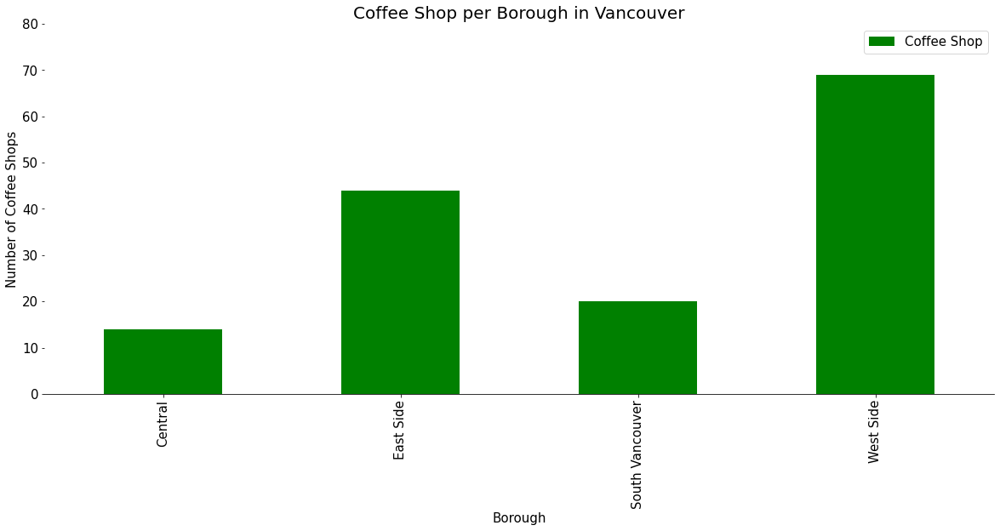

In [105]:
ax01 = van_cafe2.plot(kind = 'bar',color = 'green', figsize = (20,8), fontsize = 15, align = 'center')
ax01.set_title('Coffee Shop per Borough in Vancouver', fontsize = 20)
ax01.legend(fontsize = 15)
ax01.set_xlabel('Borough',fontsize = 15)
ax01.set_ylabel('Number of Coffee Shops',fontsize =15)
ax01.set_ylim(0,80)
ax01.spines['top'].set_visible(False)
ax01.spines['left'].set_visible(False)
ax01.spines['right'].set_visible(False)
plt.show()

In [99]:
van_pop2=van_pop_df.groupby('Borough')['Population'].sum()
van_pop2

Borough
Central             99256
East Side          255905
South Vancouver     60821
West Side          190764
Name: Population, dtype: int64

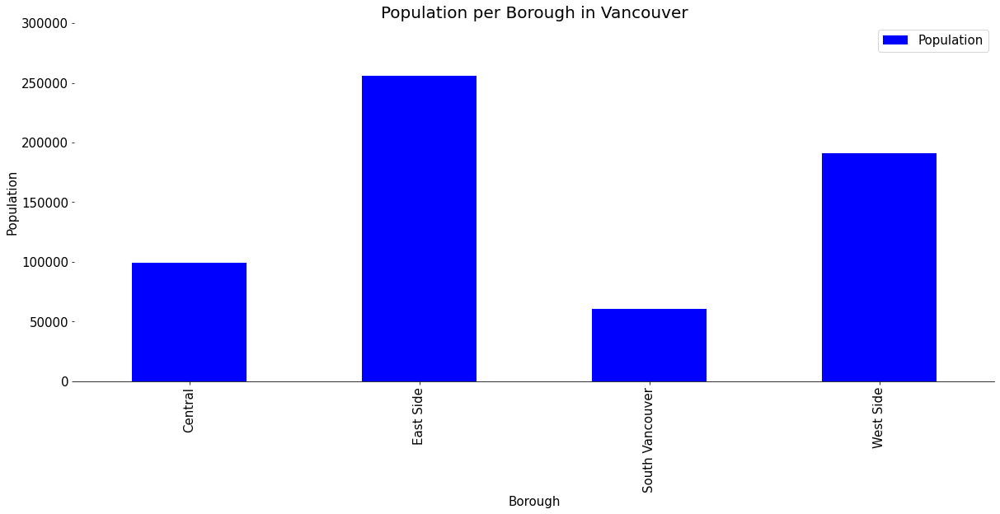

In [109]:
ax01 = van_pop2.plot(kind = 'bar',color = 'blue', figsize = (20,8), fontsize = 15, align = 'center')
ax01.set_title('Population per Borough in Vancouver', fontsize = 20)
ax01.legend(fontsize = 15)
ax01.set_xlabel('Borough',fontsize = 15)
ax01.set_ylabel('Population',fontsize =15)
ax01.set_ylim(0,300000)
ax01.spines['top'].set_visible(False)
ax01.spines['left'].set_visible(False)
ax01.spines['right'].set_visible(False)
plt.show()

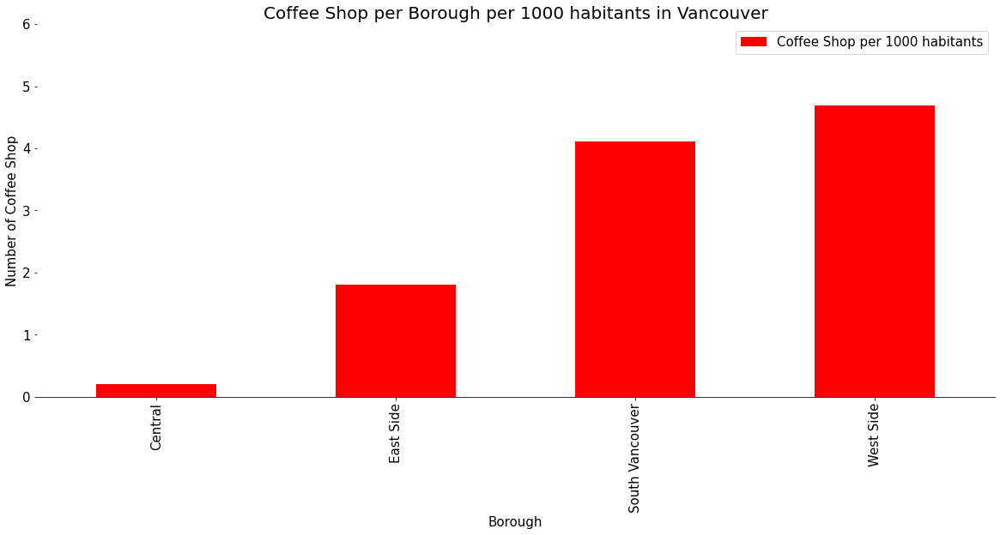

In [110]:
van_cafe_data_thousand2 = van_cafe_data_thousand.groupby('Borough')['Coffee Shop per 1000 habitants'].sum()
ax01 = van_cafe_data_thousand2.plot(kind = 'bar',color = 'red', figsize = (20,8), fontsize = 15, align = 'center')
ax01.set_title('Coffee Shop per Borough per 1000 habitants in Vancouver', fontsize = 20)
ax01.legend(fontsize = 15)
ax01.set_xlabel('Borough',fontsize = 15)
ax01.set_ylabel('Number of Coffee Shop',fontsize =15)
ax01.set_ylim(0,6)
ax01.spines['top'].set_visible(False)
ax01.spines['left'].set_visible(False)
ax01.spines['right'].set_visible(False)
plt.show()

In [100]:
van_cafe_data_thousand.groupby('Borough')['Coffee Shop per 1000 habitants'].sum()

Borough
Central            0.209464
East Side          1.799653
South Vancouver    4.108447
West Side          4.683445
Name: Coffee Shop per 1000 habitants, dtype: float64

The objective of this business project was to support stakeholders to identify one of the safest borough/neighborhood in Vancouver with a considerable number of habitants in order to open a Coffee Shop. I was only able to conclude this task because I first made use of Vancouver crime data, available at Kaggle, to identify a borugh that can be considerate safe with considerable number of habitants and an opportunity to open a venue there.

### 6.Conclusion<a id="6"></a>

Based on exploratory data analysis of the crimes per Borough we can see that South Vancouver has the lowest crimes.
Since South Vancouver has very little number of neighborhoods, only 3, and the number of habitants is 60.821. It is the smallest Cluster. When you compare Coffee Shop per Borough x 1000 Habitants you can see they are in second. Therefore the South Vancouver Cluster, Cluster N.3 is not a good option.

The next borough with lowest crime is West Side. West Side borough is the second borough with more habitants, 190.764 people live there. It is the first Borough in number of Coffee Shops per 1000 Habitants. Even though they have approximately 5 Coffee Shops per a thousand habitants the borough still have opportunities to have more Coffee Shops, as you can see in the Map with Clusters, between cluster N.2 and N.4, specially between Neighbourdhoods Dunbar-Southlands and Musqueam, there is a space with no venues related to Coffee Shops, Café, Cafeteria, Bubble Tea and other competitors. The largest Univeristy in the West Coast of Canada, UBC (University of British Columbia), is in the West Side Borough, also this borough has the richest neighbouhoods in Vancouver. Therefore, I see an opportunity to open a Coffee Shop there.

Last but not least, different types of crimes were recorded in the West Side Borough. Crimes like Breank and Enter Commercial is low among other types of crime.